# Import Packages

In [386]:
%load_ext autoreload
%autoreload 2
#%reload_ext autoreload
import glob
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import geopandas
import geopy
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import statsmodels.api as sm
import statsmodels.stats.api as sms
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import linear_rainbow, het_breuschpagan
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.metrics import mean_squared_error, make_scorer
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
import folium.plugins as plugins
import math
from math import sin, cos, sqrt, atan2, radians
from haversine import haversine
from itertools import combinations
import json
%matplotlib inline
pd.set_option("display.max_columns", 200)
pd.set_option("display.max_rows", 200)
import sys
import os
path_to_src = os.path.join('..\src')
sys.path.insert(0, path_to_src)
from useful_functions import *
import plotly.express as px

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Data

The data was downloaded directly from the [Driven Data](https://www.drivendata.org/competitions/7/pump-it-up-data-mining-the-water-table/page/23/)

A summary of the features was provided:
- amount_tsh - Total static head (amount water available to waterpoint)
- date_recorded - The date the row was entered
- funder - Who funded the well
- gps_height - Altitude of the well
- installer - Organization that installed the well
- longitude - GPS coordinate
- latitude - GPS coordinate
- wpt_name - Name of the waterpoint if there is one
- num_private -
- basin - Geographic water basin
- subvillage - Geographic location
- region - Geographic location
- region_code - Geographic location (coded)
- district_code - Geographic location (coded)
- lga - Geographic location
- ward - Geographic location
- population - Population around the well
- public_meeting - True/False
- recorded_by - Group entering this row of data
- scheme_management - Who operates the waterpoint
- scheme_name - Who operates the waterpoint
- permit - If the waterpoint is permitted
- construction_year - Year the waterpoint was constructed
- extraction_type - The kind of extraction the waterpoint uses
- extraction_type_group - The kind of extraction the waterpoint uses
- extraction_type_class - The kind of extraction the waterpoint uses
- management - How the waterpoint is managed
- management_group - How the waterpoint is managed
- payment - What the water costs
- payment_type - What the water costs
- water_quality - The quality of the water
- quality_group - The quality of the water
- quantity - The quantity of water
- quantity_group - The quantity of water
- source - The source of the water
- source_type - The source of the water
- source_class - The source of the water
- waterpoint_type - The kind of waterpoint
- waterpoint_type_group - The kind of waterpoint

Each water well is labelled as one of the 3 categories:

- functional - the waterpoint is operational and there are no repairs needed
- functional needs repair - the waterpoint is operational, but needs repairs
- non functional - the waterpoint is not operational

### Importing the data

In [85]:
X = pd.read_csv('../data/features.csv')
y = pd.read_csv('../data/labels.csv')

# test_data taken from drivendata for competition submissions
test = pd.read_csv('../data/test_vals.csv')

# check shape of dataframe
X.shape

(59400, 40)

In [86]:
# check shape of target variable
y.head()
y.shape

(59400, 2)

looks like the two dataframes share the id column, I will merge the two before commencing thorough data cleaning.

In [87]:
df = pd.concat([X,y], axis=1)

In [88]:
df.shape

(59400, 42)

In [89]:
df.columns = ['id', 'amount_tsh', 'date_recorded', 'funder', 'gps_height',
       'installer', 'longitude', 'latitude', 'wpt_name', 'num_private',
       'basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga',
       'ward', 'population', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'construction_year',
       'extraction_type', 'extraction_type_group', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality', 'quality_group', 'quantity', 'quantity_group',
       'source', 'source_type', 'source_class', 'waterpoint_type',
       'waterpoint_type_group', 'id_1', 'status_group']

In [90]:
df.head()

,id,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,id_1,status_group
0,69572,6000.0,2011-03-14,Roman,1390,Roman,34.938093,-9.856322,none,0,Lake Nyasa,Mnyusi B,Iringa,11,5,Ludewa,Mundindi,109,True,GeoData Consultants Ltd,VWC,Roman,False,1999,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,69572,functional
1,8776,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,NaN,GeoData Consultants Ltd,Other,NaN,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,8776,functional
2,34310,25.0,2013-02-25,Lottery Club,686,World vision,37.460664,-3.821329,Kwa Mahundi,0,Pangani,Majengo,Manyara,21,4,Simanjiro,Ngorika,250,True,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,2009,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe,34310,functional
3,67743,0.0,2013-01-28,Unicef,263,UNICEF,38.486161,-11.155298,Zahanati Ya Nanyumbu,0,Ruvuma / Southern Coast,Mahakamani,Mtwara,90,63,Nanyumbu,Nanyumbu,58,True,GeoData Consultants Ltd,VWC,NaN,True,1986,submersible,submersible,submersible,vwc,user-group,never pay,never pay,soft,good,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,67743,non functional
4,19728,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,NaN,NaN,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,19728,functional


Check that all of the entries in both dataframes had matching id columns

In [91]:
len(df[df['id']==df['id_1']])

59400

Lets check what the data looks like at a high level

In [92]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 42 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

Looks like there are a few features with missing entries, there may be duplicates too, all worth checking. First let's confirm these null values. 

In [93]:
df.isna().sum()

id                           0
amount_tsh                   0
date_recorded                0
funder                    3635
gps_height                   0
installer                 3655
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

There are 7 features that contain missing values to varying degrees of severity. Further inspection will be required when determining whether to remove these rows altogether or impute a value. scheme_name however has over 28,000 null values out of a dataset of 59,400 so it's likely this feature will be removed.

In [50]:
import pandas_profiling
from pandas_profiling import ProfileReport

In [55]:
pandas_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/55 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [56]:
profile.to_widgets()

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [18]:
df.scheme_name.value_counts()

K                             682
None                          644
Borehole                      546
Chalinze wate                 405
M                             400
                             ... 
BRA                             1
Hivuga Water Supply             1
BL Lamaungu                     1
NYA /MAK BUK/ piped scheme      1
Kiranjeranje  Water supply      1
Name: scheme_name, Length: 2696, dtype: int64

By running pandas-profiling on the dataset, it can quickly inform of features that have issues worth investigating. 
In this instance it has highlighted 'recorded_by' as being constant, let's confirm this and then drop. 

In [19]:
df.recorded_by.value_counts()

GeoData Consultants Ltd    59400
Name: recorded_by, dtype: int64

In [94]:
df.drop(['recorded_by'], axis=1, inplace=True)

47% of 'scheme_name' values are missing, the feature also has very high cardinality, 2696 unique entries.

In [21]:
df.scheme_name.value_counts()

K                             682
None                          644
Borehole                      546
Chalinze wate                 405
M                             400
                             ... 
BRA                             1
Hivuga Water Supply             1
BL Lamaungu                     1
NYA /MAK BUK/ piped scheme      1
Kiranjeranje  Water supply      1
Name: scheme_name, Length: 2696, dtype: int64

In [22]:
df.scheme_name.isna().sum()

28166

In [95]:
#Drop scheme_name column
df.drop(['scheme_name'], axis=1, inplace=True)

The next feature I will check is the 'amount_tsh' which is the vertical distance between the water and the water discharge point. 

In [24]:
df['amount_tsh'].value_counts()

0.00         41639
500.00        3102
50.00         2472
1000.00       1488
20.00         1463
200.00        1220
100.00         816
10.00          806
30.00          743
2000.00        704
250.00         569
300.00         557
5000.00        450
5.00           376
25.00          356
3000.00        334
1200.00        267
1500.00        197
6.00           190
600.00         176
4000.00        156
2400.00        145
2500.00        139
6000.00        125
7.00            69
8000.00         61
750.00          59
40.00           59
10000.00        57
12000.00        51
20000.00        45
450.00          42
3600.00         42
400.00          42
2200.00         31
700.00          24
4700.00         23
70.00           23
150.00          21
33.00           20
15000.00        16
60.00           15
15.00           15
2800.00         14
2.00            13
7200.00         12
1300.00         10
25000.00         9
6500.00          9
7500.00          8
35.00            8
30000.00         8
7000.00     

As per the pandas profiling, over 70% of this column has zero value. This would make it very difficult to impute a number that would add value to the analysis, any conclusions drawn using this feature would have to be taken with a pinch of salt. Although the feature itself would likely be very important in how a water supply would function, the data is not useable in its current form. I will therefore drop this feature. 

In [96]:
# drop total static head
df.drop(['amount_tsh'], axis=1, inplace=True)

'wpt_name' has high cardinality but also unlikely to be an important factor in determining a pumps condition, I will drop this column

In [97]:
df.drop(['wpt_name'], axis=1, inplace=True)

'region_code' has no missing values but according to the description of the features, it is a coded duplication of the region column

In [27]:
df.region_code.describe()

count    59400.000000
mean        15.297003
std         17.587406
min          1.000000
25%          5.000000
50%         12.000000
75%         17.000000
max         99.000000
Name: region_code, dtype: float64

In [28]:
df.region_code.value_counts()

11    5300
17    5011
12    4639
3     4379
5     4040
18    3324
19    3047
2     3024
16    2816
10    2640
4     2513
1     2201
13    2093
14    1979
20    1969
15    1808
6     1609
21    1583
80    1238
60    1025
90     917
7      805
99     423
9      390
24     326
8      300
40       1
Name: region_code, dtype: int64

In [29]:
df.region.value_counts()

Iringa           5294
Shinyanga        4982
Mbeya            4639
Kilimanjaro      4379
Morogoro         4006
Arusha           3350
Kagera           3316
Mwanza           3102
Kigoma           2816
Ruvuma           2640
Pwani            2635
Tanga            2547
Dodoma           2201
Singida          2093
Mara             1969
Tabora           1959
Rukwa            1808
Mtwara           1730
Manyara          1583
Lindi            1546
Dar es Salaam     805
Name: region, dtype: int64

The region column certainly appears more useful, I will drop the region_code

In [98]:
df.drop(['region_code'], axis=1, inplace=True)

The payment and payment type features are given the same description. I suspect it is the same information in both and therefore one can be dropped. Let's investigate.

In [31]:
df[['payment', 'payment_type']].value_counts()

payment                payment_type
never pay              never pay       25348
pay per bucket         per bucket       8985
pay monthly            monthly          8300
unknown                unknown          8157
pay when scheme fails  on failure       3914
pay annually           annually         3642
other                  other            1054
dtype: int64

I will drop payment_type as it is a duplicate of payment.

In [99]:
df.drop(['payment_type'], axis=1, inplace=True)

id_1 can be drop as it is just a duplicate of the id column

In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 36 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   date_recorded          59400 non-null  object 
 2   funder                 55765 non-null  object 
 3   gps_height             59400 non-null  int64  
 4   installer              55745 non-null  object 
 5   longitude              59400 non-null  float64
 6   latitude               59400 non-null  float64
 7   num_private            59400 non-null  int64  
 8   basin                  59400 non-null  object 
 9   subvillage             59029 non-null  object 
 10  region                 59400 non-null  object 
 11  district_code          59400 non-null  int64  
 12  lga                    59400 non-null  object 
 13  ward                   59400 non-null  object 
 14  population             59400 non-null  int64  
 15  pu

In [34]:
df[['management', 'management_group']].value_counts()

management        management_group
vwc               user-group          40507
wug               user-group           6515
water board       user-group           2933
wua               user-group           2535
private operator  commercial           1971
parastatal        parastatal           1768
water authority   commercial            904
other             other                 844
company           commercial            685
unknown           unknown               561
other - school    other                  99
trust             commercial             78
dtype: int64

In [35]:
df.management.value_counts()

vwc                 40507
wug                  6515
water board          2933
wua                  2535
private operator     1971
parastatal           1768
water authority       904
other                 844
company               685
unknown               561
other - school         99
trust                  78
Name: management, dtype: int64

In [36]:
df.management_group.value_counts()

user-group    52490
commercial     3638
parastatal     1768
other           943
unknown         561
Name: management_group, dtype: int64

In [37]:
df.scheme_management.value_counts()

VWC                 36793
WUG                  5206
Water authority      3153
WUA                  2883
Water Board          2748
Parastatal           1680
Private operator     1063
Company              1061
Other                 766
SWC                    97
Trust                  72
None                    1
Name: scheme_management, dtype: int64

In [38]:
df[['management', 'management_group', 'scheme_management']].isna().sum()

management              0
management_group        0
scheme_management    3877
dtype: int64

These three features contain very similar information, I see no value in keeping all three. I will drop management_group and scheme_management. management_group doesn't have as much granularity as management, and scheme_management has 3877 missing values.

In [101]:
df.drop(['management_group', 'scheme_management'], axis=1, inplace=True)

it looks like there may be some duplication in the extraction features too, I will inspect these more closely now

In [40]:
df.extraction_type.value_counts()

gravity                      26780
nira/tanira                   8154
other                         6430
submersible                   4764
swn 80                        3670
mono                          2865
india mark ii                 2400
afridev                       1770
ksb                           1415
other - rope pump              451
other - swn 81                 229
windmill                       117
india mark iii                  98
cemo                            90
other - play pump               85
walimi                          48
climax                          32
other - mkulima/shinyanga        2
Name: extraction_type, dtype: int64

In [126]:
df.extraction_type_group.value_counts()

gravity            26780
nira/tanira         8154
other               6430
submersible         6179
swn 80              3670
mono                2865
india mark ii       2400
afridev             1770
rope pump            451
other handpump       364
other motorpump      122
wind-powered         117
india mark iii        98
Name: extraction_type_group, dtype: int64

In [127]:
df.extraction_type_class.value_counts()

gravity         26780
handpump        16456
other            6430
submersible      6179
motorpump        2987
rope pump         451
wind-powered      117
Name: extraction_type_class, dtype: int64

extraction_type provides more information than the other two categories but isn't high cardinality, I will keep this and drop the other two. 

In [100]:
df.drop(['extraction_type_class', 'extraction_type_group'], axis=1, inplace=True)

source will be the next features to explore for potential drops. 

In [42]:
df.source.value_counts()

spring                  17021
shallow well            16824
machine dbh             11075
river                    9612
rainwater harvesting     2295
hand dtw                  874
lake                      765
dam                       656
other                     212
unknown                    66
Name: source, dtype: int64

In [43]:
df.source_type.value_counts()

spring                  17021
shallow well            16824
borehole                11949
river/lake              10377
rainwater harvesting     2295
dam                       656
other                     278
Name: source_type, dtype: int64

In [44]:
df.source_class.value_counts()

groundwater    45794
surface        13328
unknown          278
Name: source_class, dtype: int64

as with extraction, I will keep the source feature that provides the most granularity in this case 'source'

In [102]:
df.drop(['source_class', 'source_type'], axis=1, inplace=True)

Now I will check the water_quality and quality_group features as I suspect there is also duplication there

In [45]:
df.water_quality.value_counts()

soft                  50818
salty                  4856
unknown                1876
milky                   804
coloured                490
salty abandoned         339
fluoride                200
fluoride abandoned       17
Name: water_quality, dtype: int64

In [46]:
df.quality_group.value_counts()

good        50818
salty        5195
unknown      1876
milky         804
colored       490
fluoride      217
Name: quality_group, dtype: int64

Again, I will keep the feature that has slightly more detailed information, the water_quality feature adds detail about abandonement.

In [103]:
df.drop(['quality_group'], axis=1, inplace=True)

I will now check waterpoint out

In [48]:
df.waterpoint_type.value_counts()

communal standpipe             28522
hand pump                      17488
other                           6380
communal standpipe multiple     6103
improved spring                  784
cattle trough                    116
dam                                7
Name: waterpoint_type, dtype: int64

In [49]:
df.waterpoint_type_group.value_counts()

communal standpipe    34625
hand pump             17488
other                  6380
improved spring         784
cattle trough           116
dam                       7
Name: waterpoint_type_group, dtype: int64

as with other features, I will keep the feature here that contains more granularity - waterpoint_type

In [104]:
df.drop(['waterpoint_type_group'], axis=1, inplace=True)

checking quantity features now

In [51]:
df.quantity.value_counts()

enough          33186
insufficient    15129
dry              6246
seasonal         4050
unknown           789
Name: quantity, dtype: int64

In [52]:
df.quantity_group.value_counts()

enough          33186
insufficient    15129
dry              6246
seasonal         4050
unknown           789
Name: quantity_group, dtype: int64

these features are just replicas, I will drop quantity group

In [105]:
df.drop(['quantity_group'], axis=1, inplace=True)

In [106]:
df.drop(['id_1'], axis=1, inplace=True)

Another check of the value counts for each feature just to see where we are up to...

In [55]:
for col in df.columns:
    print(col)
    print(df[col].value_counts())

id
0        1
19811    1
38200    1
34106    1
36155    1
        ..
64138    1
62091    1
51852    1
49805    1
2047     1
Name: id, Length: 59400, dtype: int64
date_recorded
2011-03-15    572
2011-03-17    558
2013-02-03    546
2011-03-14    520
2011-03-16    513
             ... 
2011-09-21      1
2011-09-18      1
2011-09-05      1
2011-08-31      1
2004-07-01      1
Name: date_recorded, Length: 356, dtype: int64
funder
Government Of Tanzania    9084
Danida                    3114
Hesawa                    2202
Rwssp                     1374
World Bank                1349
                          ... 
Nmdc India                   1
Sido                         1
Kajima                       1
Msikitini                    1
Zinduka                      1
Name: funder, Length: 1897, dtype: int64
gps_height
 0       20438
-15         60
-16         55
-13         55
 1290       52
         ...  
 2332        1
 2202        1
 2236        1
-57          1
 2038        1
Name: gps_heig

num_private is almost entirely zeros and it also has no description so I will remove this feature,

In [107]:
df.drop(['num_private'], axis=1, inplace=True)

It appears that basin, subvillage, region, district_code, Iga and ward all relate to geographical location. There may be an opportunity to drop some redundant features here.

It is at this point, before I start imputing values, I will split the data set into two to create a validation dataframe. In the process I will therefore only impute values using the training data set as to avoid data leakage.

### Creating Test Data Set

In [192]:
df_1 = df.iloc[:40000,:].copy()
df_2 = df.iloc[40001:,:].copy()

In [193]:
df_2.describe()

,id,gps_height,longitude,latitude,district_code,population,construction_year
count,19399.000000,19399.000000,19399.000000,1.939900e+04,19399.000000,19399.000000,19399.000000
mean,37216.801536,671.511057,34.042661,-5.705648e+00,5.610238,176.923089,1305.149544
std,21334.027027,695.310029,6.619835,2.947316e+00,9.603689,436.903295,950.249388
min,9.000000,-90.000000,0.000000,-1.164944e+01,0.000000,0.000000,0.000000
25%,18707.000000,0.000000,33.082153,-8.523688e+00,2.000000,0.000000,0.000000
50%,37188.000000,369.000000,34.899213,-5.033428e+00,3.000000,30.000000,1986.000000
75%,55484.500000,1322.000000,37.151659,-3.328937e+00,5.000000,217.000000,2004.000000
max,74239.000000,2628.000000,40.344301,-2.000000e-08,80.000000,11463.000000,2013.000000


In [194]:
df_1.describe()

,id,gps_height,longitude,latitude,district_code,population,construction_year
count,40000.00000,40000.000000,40000.000000,4.000000e+04,40000.000000,40000.000000,40000.000000
mean,37065.60655,666.755325,34.095139,-5.706362e+00,5.639300,181.363050,1298.504025
std,21510.96777,692.053947,6.539744,2.945325e+00,9.648353,487.372991,952.278792
min,0.00000,-63.000000,0.000000,-1.158630e+01,0.000000,0.000000,0.000000
25%,18416.75000,0.000000,33.096949,-8.548747e+00,2.000000,0.000000,0.000000
50%,37002.00000,369.000000,34.911780,-5.017099e+00,3.000000,25.000000,1985.000000
75%,55748.25000,1318.000000,37.191080,-3.324508e+00,5.000000,213.000000,2004.000000
max,74247.00000,2770.000000,40.345193,-2.000000e-08,80.000000,30500.000000,2013.000000


I will now check again the features with null values

In [195]:
df_1.isna().sum()

id                      0
date_recorded           0
funder               2413
gps_height              0
installer            2432
longitude               0
latitude                0
basin                   0
subvillage            247
region                  0
district_code           0
lga                     0
ward                    0
population              0
public_meeting       2250
permit               2041
construction_year       0
extraction_type         0
management              0
payment                 0
water_quality           0
quantity                0
source                  0
waterpoint_type         0
status_group            0
dtype: int64

Start off with public meeting, I will see if there is something that can be done with those missing values.

In [112]:
df_1.public_meeting.value_counts()

True     34336
False     3414
Name: public_meeting, dtype: int64

I will fill the missing values in this feature with the mode 'True'

In [196]:
df_1['public_meeting'].fillna(True, inplace=True)
# I will need to do this for both the validation set and test set
df_2['public_meeting'].fillna(True, inplace=True)
test['public_meeting'].fillna(True, inplace=True)

Now to check the same with the 'permit' feature

In [197]:
df_1.permit.value_counts()

True     26168
False    11791
Name: permit, dtype: int64

As with the public_meeting feature, I will fill the permit null values with the mode - True

In [198]:
df_1['permit'].fillna(True, inplace=True)
# I will need to do this for both the validation set and test set
df_2['permit'].fillna(True, inplace=True)
test['permit'].fillna(True, inplace=True)

Now to check the installer category

In [199]:
df_1.installer.value_counts()

DWE                  11736
Government            1241
RWE                    808
DANIDA                 713
Commu                  705
                     ...  
Mohamad Masanga          1
TANEDAPS Society         1
Mtwara Technician        1
VIFAF                    1
Makala                   1
Name: installer, Length: 1739, dtype: int64

I will now review the latitude and longitude data.

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


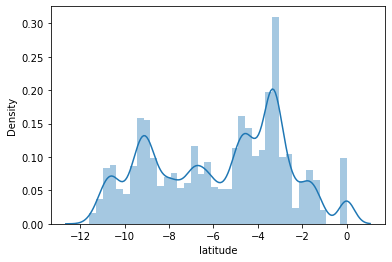

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


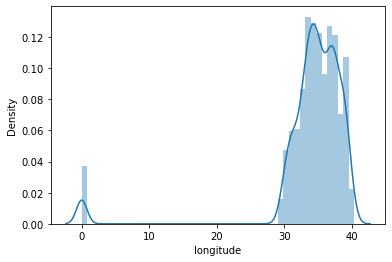

In [200]:
for col in ['latitude', 'longitude']:
    fig = sns.distplot(df_1[col])
    plt.show()

It looks like there is a clear error in the data gathered, in both categories there are many zeroes. Plotting these points on the map you can see they land in atlantic ocean, due south of Ghana. (nowhere near Tanzania)
I will correct these entries so they are corrected to an average based on their subvillage

In [201]:
#rounding columns to manageable decimal place
df_1.longitude = df.longitude.round(2)
df_1.latitude = df.latitude.round(2)

# Doing the same for test and validation set
df_2.longitude = df_2.longitude.round(2)
df_2.latitude = df_2.latitude.round(2)

# Doing the same for test and validation set
test.longitude = test.longitude.round(2)
test.latitude = test.latitude.round(2)


In [202]:
# create a function for filling null values with an average of my choosing

def fill_df(df, region, feature, method):
    return df[feature].fillna(df.groupby([region])[feature].transform(method), inplace=True)

In [203]:
df_1.loc[df_1.longitude == 0, 'longitude'] = np.nan
df_1.longitude.isna().sum()

1207

In [204]:
df_2.loc[df_2.longitude == 0, 'longitude'] = np.nan
df_2.longitude.isna().sum()

604

In [205]:
test.loc[test.longitude == 0, 'longitude'] = np.nan
test.longitude.isna().sum()

0

fill the train data

In [206]:
fill_df(df_1, 'subvillage', 'longitude', 'mean')
fill_df(df_1, 'ward', 'longitude', 'mean')
fill_df(df_1, 'lga', 'longitude', 'mean')
df_1.longitude.isna().sum()

0

In [207]:
fill_df(df_2, 'subvillage', 'longitude', 'mean')
fill_df(df_2, 'ward', 'longitude', 'mean')
fill_df(df_2, 'lga', 'longitude', 'mean')
fill_df(df_2, 'district_code', 'longitude', 'mean')
df_2.longitude.isna().sum()

0

fill the test data now with data from train set

In [208]:
fill_df(test, 'subvillage', 'longitude', 'mean')
fill_df(test, 'ward', 'longitude', 'mean')
fill_df(test, 'lga', 'longitude', 'mean')
fill_df(test, 'district_code', 'longitude', 'mean')
test.longitude.isna().sum()

0

I will repeat the above exercise for latitude

In [209]:
df_1.loc[df_1.latitude == 0, 'latitude'] = np.nan
df_1.latitude.isna().sum()

1207

In [210]:
df_2.loc[df_2.latitude == 0, 'latitude'] = np.nan
df_2.latitude.isna().sum()

604

In [211]:
test.loc[test.latitude == 0, 'latitude'] = np.nan
test.latitude.isna().sum()

0

In [212]:
#fill training set
fill_df(df_1, 'subvillage', 'latitude', 'mean')
fill_df(df_1, 'ward', 'latitude', 'mean')
fill_df(df_1, 'lga', 'latitude', 'mean')
df_1.latitude.isna().sum()

0

In [213]:
# fill validation set
fill_df(df_2, 'subvillage', 'latitude', 'mean')
fill_df(df_2, 'ward', 'latitude', 'mean')
fill_df(df_2, 'lga', 'latitude', 'mean')

df_2.latitude.isna().sum()

0

In [214]:
# fill competition data 
fill_df(test, 'subvillage', 'latitude', 'mean')
fill_df(test, 'ward', 'latitude', 'mean')
fill_df(test, 'lga', 'latitude', 'mean')
test.latitude.isna().sum()

0

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


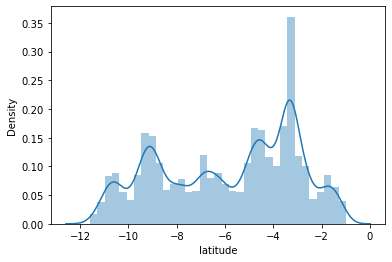

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


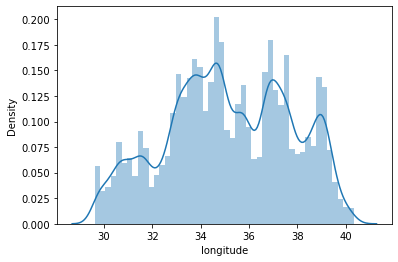

In [215]:
# check the distributions now
for col in ['latitude', 'longitude']:
    fig = sns.distplot(df_1[col])
    plt.show()

The distributions of longitude and latitude look much better now, I will move on to other features.

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='gps_height', ylabel='Density'>

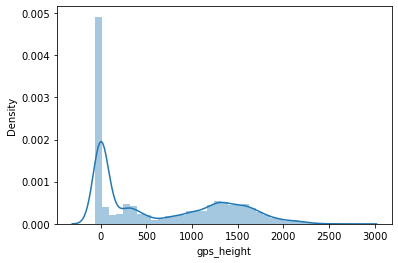

In [216]:
# exploring gps height
sns.distplot(df_1['gps_height'])

as with the long and lat features, there are many 0 entires in the gps height and negative, whilst zero isn't beyond the realms of possibility, I will replace these values with average gps height for a region/ward/lga

In [217]:
df_1.loc[df_1.gps_height <= 0, 'gps_height'] = np.nan
df_1.gps_height.isna().sum()

14779

In [218]:
df_1.head()

,id,date_recorded,funder,gps_height,installer,longitude,latitude,basin,subvillage,region,district_code,lga,ward,population,public_meeting,permit,construction_year,extraction_type,management,payment,water_quality,quantity,source,waterpoint_type,status_group
0,69572,2011-03-14,Roman,1390.0,Roman,34.94,-9.86,Lake Nyasa,Mnyusi B,Iringa,5,Ludewa,Mundindi,109,True,False,1999,gravity,vwc,pay annually,soft,enough,spring,communal standpipe,functional
1,8776,2013-03-06,Grumeti,1399.0,GRUMETI,34.70,-2.15,Lake Victoria,Nyamara,Mara,2,Serengeti,Natta,280,True,True,2010,gravity,wug,never pay,soft,insufficient,rainwater harvesting,communal standpipe,functional
2,34310,2013-02-25,Lottery Club,686.0,World vision,37.46,-3.82,Pangani,Majengo,Manyara,4,Simanjiro,Ngorika,250,True,True,2009,gravity,vwc,pay per bucket,soft,enough,dam,communal standpipe multiple,functional
3,67743,2013-01-28,Unicef,263.0,UNICEF,38.49,-11.16,Ruvuma / Southern Coast,Mahakamani,Mtwara,63,Nanyumbu,Nanyumbu,58,True,True,1986,submersible,vwc,never pay,soft,dry,machine dbh,communal standpipe multiple,non functional
4,19728,2011-07-13,Action In A,NaN,Artisan,31.13,-1.83,Lake Victoria,Kyanyamisa,Kagera,1,Karagwe,Nyakasimbi,0,True,True,0,gravity,other,never pay,soft,seasonal,rainwater harvesting,communal standpipe,functional


In [219]:
fill_df(df_1, 'subvillage', 'gps_height', 'mean')
fill_df(df_1, 'ward', 'gps_height', 'mean')
fill_df(df_1, 'lga', 'gps_height', 'mean')
df_1.gps_height.isna().sum()

64

In [220]:
fill_df(df_1, 'district_code', 'gps_height', 'mean')
df.gps_height.isna().sum()

0

In [ ]:
# repeat for test and validation data

In [147]:
df_2.loc[df_2.gps_height <= 0, 'gps_height'] = np.nan
df_2.gps_height.isna().sum()

7154

In [148]:
test.loc[test.gps_height <= 0, 'gps_height'] = np.nan
test.gps_height.isna().sum()

5596

In [221]:
# such a high proportion of 0 or negative values in all sets, I think I will remove this feature entirely
df_1.drop(['gps_height'], axis=1, inplace=True)
df_2.drop(['gps_height'], axis=1, inplace=True)
test.drop(['gps_height'], axis=1, inplace=True)

KeyError: "['gps_height'] not found in axis"

Another check of null values

In [243]:
df.isna().sum()

id                      0
date_recorded           0
funder               3635
gps_height              0
installer            3655
longitude               0
latitude                0
basin                   0
subvillage            371
region                  0
district_code           0
lga                     0
ward                    0
population              0
public_meeting          0
permit                  0
construction_year       0
extraction_type         0
management              0
payment                 0
water_quality           0
quantity                0
source                  0
waterpoint_type         0
status_group            0
dtype: int64

The number of subvillage rows with missing information is so little, it may be worth dropping them. However I can easily group them into another category


In [222]:
df_1.subvillage = df_1.subvillage.str.lower()
df_1.loc[df.subvillage.str.len() < 2, 'subvillage'] = 'other'
df_1.subvillage.fillna('other', inplace=True)

In [224]:
df_2.subvillage = df_2.subvillage.str.lower()
df_2.loc[df.subvillage.str.len() < 2, 'subvillage'] = 'other'
df_2.subvillage.fillna('other', inplace=True)

In [223]:
test.subvillage = test.subvillage.str.lower()
test.loc[df.subvillage.str.len() < 2, 'subvillage'] = 'other'
test.subvillage.fillna('other', inplace=True)

In [154]:
df_1.subvillage.value_counts()

other          703
madukani       353
majengo        345
shuleni        333
kati           253
              ... 
mwamakwale       1
magandi          1
mvugwe juu       1
sungaji          1
makongoroni      1
Name: subvillage, Length: 15748, dtype: int64

I will repeat the above for the funder feature, as it also has many entries with single characters

In [155]:
len(df_1.loc[df_1.funder.str.len()<2])

630

In [156]:
df_1.funder.value_counts()

Government Of Tanzania         6126
Danida                         2109
Hesawa                         1486
World Bank                      945
Rwssp                           932
                               ... 
Sisal Estste Hale                 1
Bakwata                           1
Afya Department Lindi Rural       1
Zingibali Secondary               1
Doner And Com                     1
Name: funder, Length: 1546, dtype: int64

In [226]:
#high cardinality i will remove this
df_1.drop(['funder'], axis=1, inplace=True)
df_2.drop(['funder'], axis=1, inplace=True)
test.drop(['funder'], axis=1, inplace=True)

KeyError: "['funder'] not found in axis"

The last remaining category will null values is installer, let's explore this

In [255]:
# I will make everything lower case, this may merge some categories
df_1.installer = df_1.installer.str.lower()
df_1.installer.value_counts()

dwe                           17405
government                     1891
hesawa                         1395
rwe                            1206
commu                          1065
                              ...  
pentecost church                  1
sdp                               1
kkkt canal                        1
lomoloki                          1
baptist church of tanzania        1
Name: installer, Length: 1935, dtype: int64

In [256]:
len(df_1.loc[df_1.installer.str.len()<2])

926

I will replace the single character entries and null values with 'unknown'

In [257]:
df_1.loc[df_1.installer.str.len() < 2, 'installer'] = 'unknown'
df_1.installer.fillna('unknown', inplace=True)

In [227]:
# on second thoughts, the high cardinality make the feature impractical to use when onehotencoded - remove
df_1.drop(['installer'], axis=1, inplace=True)
df_2.drop(['installer'], axis=1, inplace=True)
test.drop(['installer'], axis=1, inplace=True)

Time to explore the population feature

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='population', ylabel='Density'>

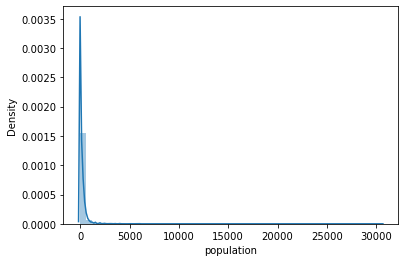

In [160]:
sns.distplot(df_1['population'])

This looks to be a very skewed distribution with many zero entries

In [228]:
df_1.population.value_counts().sort_values(ascending=False)

0       14435
1        4732
200      1294
150      1270
250      1130
        ...  
732         1
2813        1
4523        1
1193        1
882         1
Name: population, Length: 916, dtype: int64

I am going to assume that an entry of 1 or 0 is incorrect and impute entries based on subvillage, ward, region etc instead. 

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='population', ylabel='Density'>

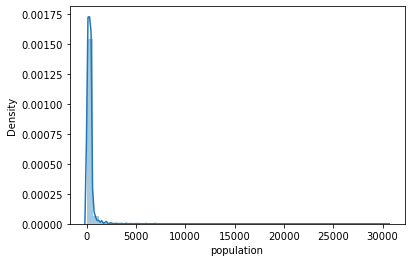

In [242]:
df_1.loc[df_1.population < 2, 'population'] = np.nan
fill_df(df_1, 'region', 'population', 'mean')
fill_df(df_1, 'subvillage', 'population', 'mean')
fill_df(df_1, 'district_code', 'population', 'mean')
sns.distplot(df_1['population'])

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='population', ylabel='Density'>

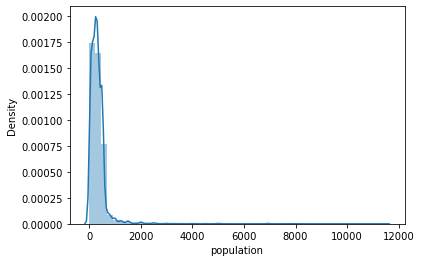

In [236]:
df_2.loc[df_2.population < 2, 'population'] = np.nan
fill_df(df_2, 'region', 'population', 'mean')
fill_df(df_2, 'district_code', 'population', 'mean')
fill_df(df_2, 'subvillage', 'population', 'mean')
sns.distplot(df_2['population'])

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='population', ylabel='Density'>

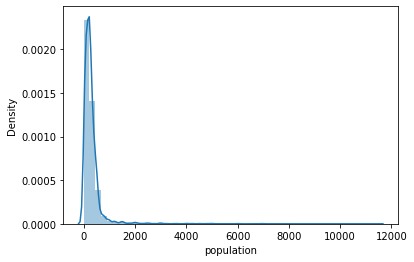

In [231]:
test.loc[test.population < 2, 'population'] = np.nan
fill_df(test, 'region', 'population', 'median')
sns.distplot(test['population'])

In [163]:
df_1.population.sort_values(ascending=False)

30537    30500.0
14308    15300.0
30231    10000.0
31363    10000.0
12784     9865.0
          ...   
39977        NaN
39985        NaN
39986        NaN
39989        NaN
39994        NaN
Name: population, Length: 40000, dtype: float64

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='population', ylabel='Density'>

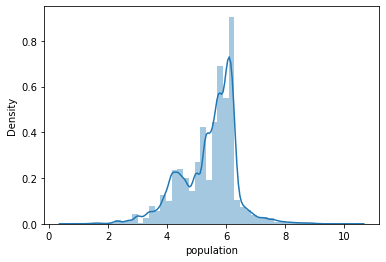

In [244]:
sns.distplot(np.log(df_1['population']))

The log distribrution looks better, I will create a new feature for this. 

In [245]:
df_1['pop_log'] = np.log(df_1.population)
df_2['pop_log'] = np.log(df_2.population)
test['pop_log'] = np.log(test.population)

In [246]:
# now drop the population 
df_1.drop(['population'], axis = 1, inplace=True)
df_2.drop(['population'], axis = 1, inplace=True)
test.drop(['population'], axis = 1, inplace=True)

I will now look at the construction year

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='construction_year', ylabel='Density'>

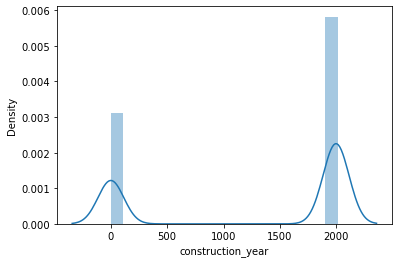

In [247]:
sns.distplot(df_1['construction_year'])

looks like many zeros again. It seems reasonable to assume pumps in areas have been built at the same time. I will replace these values with the mode of their region or other

In [248]:
df_1.loc[df.construction_year == 0, 'construction_year'] = np.nan
print(df_1.construction_year.isna().sum())
fill_df(df_1, 'region', 'construction_year', 'median')
print(df_1.construction_year.isna().sum())


13988
8165


In [249]:
fill_df(df_1, 'subvillage', 'construction_year', 'median')
print(df_1.construction_year.isna().sum())

5813


In [252]:
fill_df(df_1, 'ward', 'construction_year', 'median')
print(df_1.construction_year.isna().sum())

1065


In [253]:
fill_df(df_1, 'lga', 'construction_year', 'median')
print(df_1.construction_year.isna().sum())

63


In [254]:
fill_df(df_1, 'district_code', 'construction_year', 'median')
print(df_1.construction_year.isna().sum())

0


In [251]:
df_2.loc[df.construction_year == 0, 'construction_year'] = np.nan
print(df_2.construction_year.isna().sum())
fill_df(df_2, 'region', 'construction_year', 'median')
print(df_2.construction_year.isna().sum())

6720
3950


In [255]:
fill_df(df_2, 'ward', 'construction_year', 'median')
print(df_2.construction_year.isna().sum())

3638


In [257]:
fill_df(df_2, 'lga', 'construction_year', 'median')
print(df_2.construction_year.isna().sum())

1062


In [258]:
fill_df(df_2, 'district_code', 'construction_year', 'median')
print(df_2.construction_year.isna().sum())

0


In [314]:
#reload test data to get original construction year col
test2 = pd.read_csv('../data/test_vals.csv')
test['construction_year'] = test2.construction_year.copy()

In [315]:
test.loc[test.construction_year <1, 'construction_year'] = np.nan
print(test.construction_year.isna().sum())

5260


In [317]:
fill_df(test, 'ward', 'construction_year', 'median')
print(test.construction_year.isna().sum())

4868


In [319]:
fill_df(test, 'ward', 'construction_year', 'median')
print(test.construction_year.isna().sum())

4868


In [321]:
fill_df(test, 'lga', 'construction_year', 'median')
print(test.construction_year.isna().sum())

2513


In [323]:
fill_df(test, 'district_code', 'construction_year', 'median')
print(test.construction_year.isna().sum())

1


In [325]:
fill_df(test, 'region', 'construction_year', 'median')
print(test.construction_year.isna().sum())

0


C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='construction_year', ylabel='Density'>

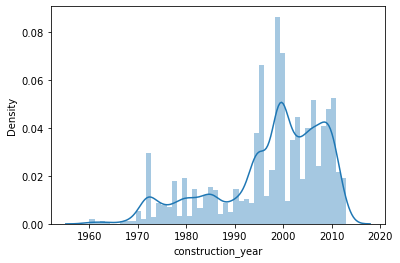

In [328]:
sns.distplot(test['construction_year'])

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='construction_year', ylabel='Density'>

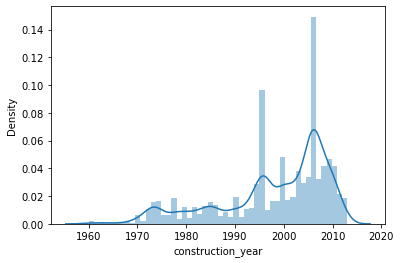

In [264]:
sns.distplot(df_2['construction_year'])

C:\Users\Andrew\anaconda3\envs\new-env\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='construction_year', ylabel='Density'>

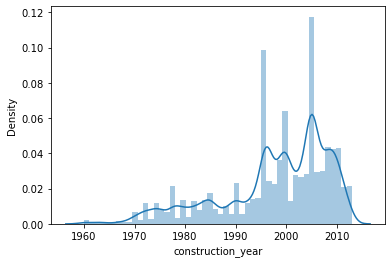

In [282]:
sns.distplot(df_1['construction_year'])

this seems reasonable although the transformation method has created some years that have disproportionate number of entries

I will now check the date_recorded feature as we will be able to determine the age of the well using this feature and the construction_year

In [329]:
df_1['date_recorded'] = pd.to_datetime(df_1['date_recorded'], infer_datetime_format=True, errors='ignore')
df_1['year_recorded'] = df_1['date_recorded'].dt.year
df_1['construction_year'] = df_1['construction_year'].astype(int)
df_1['age'] = df_1['year_recorded'] - df_1['construction_year']

<AxesSubplot:>

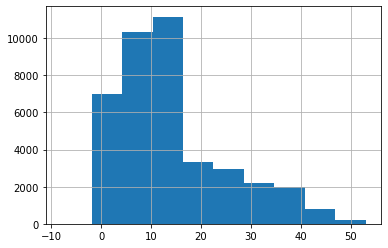

In [330]:
df_1.age.hist()

Repeat this process for both the test and validation data sets

In [331]:
df_2['date_recorded'] = pd.to_datetime(df_2['date_recorded'], infer_datetime_format=True, errors='ignore')
df_2['year_recorded'] = df_2['date_recorded'].dt.year
df_2['construction_year'] = df_2['construction_year'].astype(int)
df_2['age'] = df_2['year_recorded'] - df_2['construction_year']

In [332]:
test['date_recorded'] = pd.to_datetime(test['date_recorded'], infer_datetime_format=True, errors='ignore')
test['year_recorded'] = test['date_recorded'].dt.year
test['construction_year'] = test['construction_year'].astype(int)
test['age'] = test['year_recorded'] - test['construction_year']

I would like to change the district_code category to string

In [337]:
# change the district_zone to categorical
df_1.district_code = df_1.district_code.astype(str)
df_1.district_code = 'D' + df_1.district_code

df_2.district_code = df_2.district_code.astype(str)
df_2.district_code = 'D' + df_2.district_code

test.district_code = test.district_code.astype(str)
test.district_code = 'D' + test.district_code


In [338]:
# drop id columns from df_1 and df_2
df_1.drop(['id'], axis=1, inplace=True)
df_2.drop(['id'], axis=1, inplace=True)

Create list of columns to keep for the test data set, this is the data used to enter the competition

In [341]:
cols_keep = ['longitude', 'latitude', 'basin', 'region',
       'district_code', 'public_meeting', 'permit', 'extraction_type',
       'management', 'payment', 'water_quality', 'quantity', 'source',
       'waterpoint_type', 'pop_log', 'age']

In [342]:
# ensure df_1 and df_2 have only columns of interest
df_1 = df_1[cols_keep]
df_2 = df_2[cols_keep]

In [344]:
# ensure columns in the test are the same as other data sets, keeping ID for competition entry purposes.
test = test[['id','longitude', 'latitude', 'basin', 'region',
       'district_code', 'public_meeting', 'permit', 'extraction_type',
       'management', 'payment', 'water_quality', 'quantity', 'source',
       'waterpoint_type', 'pop_log', 'age']]

In [352]:
# add labels back
labels = pd.read_csv('../data/labels.csv')
labels_1 = labels.iloc[:40000,:].copy()
labels_2 = labels.iloc[40001:,:].copy()

I need to merge the labels back into the dataframes

In [364]:
df_1['status_group']= list(labels_1['status_group'])
df_2['status_group']= list(labels_2['status_group'])

<ipython-input-364-50992b82aa9a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_1['status_group']= list(labels_1['status_group'])


Save the cleaned data to file.

In [368]:
df_1.to_csv('../data/train.csv', index=False)
df_2.to_csv('../data/validate.csv', index=False)
test.to_csv('../data/competition.csv', index=False)

# EDA

It will be useful to explore some of the data to get a feel for which features may or may not be important.
First Though, let's see the spread of the labels.

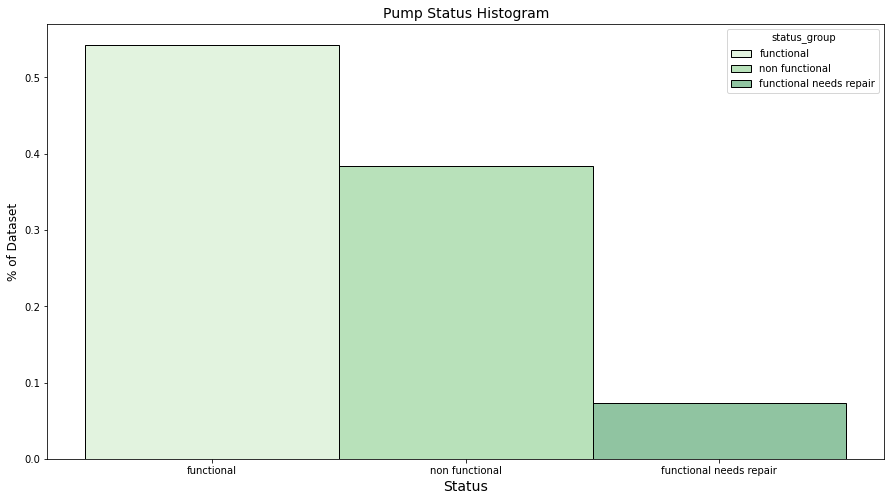

In [471]:
# hist = df['status_group'].hist(hue='status_group');
hist_plot = sns.histplot(data=df, x="status_group", hue='status_group', palette='Greens', stat='probability')
hist_plot.figure.set_size_inches(15,8)
hist_plot.set_title('Pump Status Histogram', size=14)
hist_plot.set_ylabel('% of Dataset', size=12)
hist_plot.set_xlabel('Status', size=14)
hist_plot.figure.savefig('../images/hist.jpeg', bbox_inches='tight')

I will want to check if there is any relationship between where the functional and non functional pumps are, I will create a dataset that aggregates the count for functional by region.

In [439]:
# create df that has total count for each region
counts = pd.DataFrame(df.region.value_counts())
counts['name'] = counts.index
counts.columns = ['total', 'name']

In [442]:
# create data frame that has total functional count for each region
functional_counts = pd.DataFrame(df[df['status_group']=='functional'].groupby('region')['status_group'].count())
functional_counts['name'] = functional_counts.index
functional_counts.columns = ['functional', 'name']


,functional,name
region,,
Arusha,2294,Arusha
Dar es Salaam,461,Dar es Salaam
Dodoma,1009,Dodoma
Iringa,4141,Iringa
Kagera,1727,Kagera


In [444]:
# merge the two dataframes - create feature that represents % functional
merged = pd.merge(functional_counts, counts, how='left', on='name')
merged.head()
merged['functional_%'] = (merged.functional / merged.total)*100


,functional,name,total,functional_%
0,2294,Arusha,3350,68.477612
1,461,Dar es Salaam,805,57.267081
2,1009,Dodoma,2201,45.842799
3,4141,Iringa,5294,78.220627
4,1727,Kagera,3316,52.080820


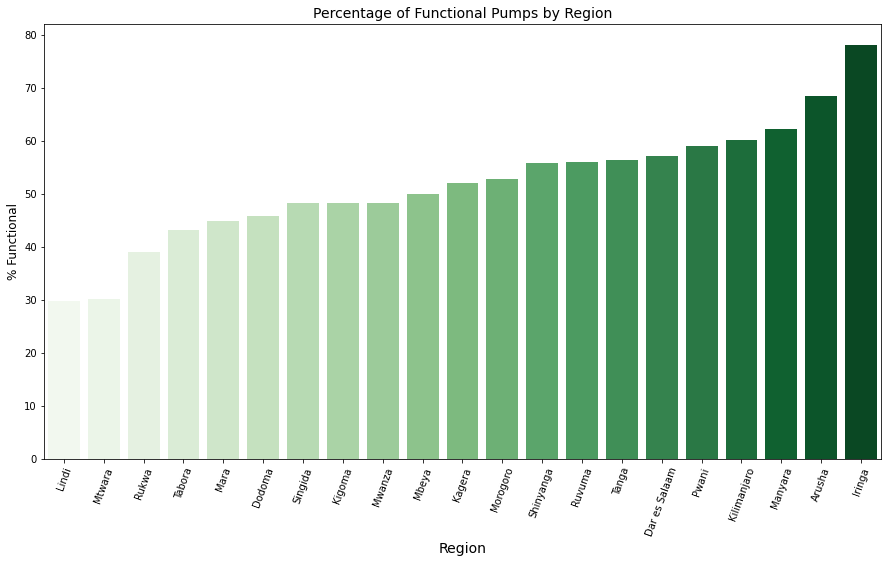

In [461]:
functional_plot = sns.barplot(x="name", y="functional_%", data=merged.sort_values(by=['functional_%']),
                 palette="Greens")
functional_plot.figure.set_size_inches(15,8)
functional_plot.set_ylabel('% Functional', size=12)
functional_plot.set_xlabel('Region', size=14)
functional_plot.set_title('Percentage of Functional Pumps by Region', size=14)
functional_plot.set_xticklabels(functional_plot.get_xticklabels(), rotation=70);
functional_plot.figure.savefig('../images/pumpregion.jpeg', bbox_inches='tight')

There is a fairly even distribution between 'functional' vs 'functional needs repair' plus 'non functional' however this minority class 'functional needs repair' could prove tricky to model accurately. These are ones that it might be more important to highlight as they could be fixed at a lower cost than full replacement as would be required in the 'non functional' category.



### Maps

In [388]:
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color='status_group',hover_name="status_group",\
                        hover_data=["status_group"], zoom=3, size='population' , width=800, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

By plotting the functional status on a map of Tanzania it provides a good indication of the importance of geography. When the markers are sized by population it is easier to see the distribution. It looks like location will be an important feature, both longitude and latitude. Many pumps have failed in the South East.

In [393]:
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color='status_group',hover_name="status_group",\
                        hover_data=["status_group"], zoom=3, opacity=0.2 , width=800, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


I will now check what the proportion of failed pumps is by quantity

### Quantity of Water EDA

In [463]:
# create df that has total count for each region
counts2 = pd.DataFrame(df.quantity.value_counts())
counts2['name'] = counts2.index
counts2.columns = ['total', 'name']

In [466]:
# create data frame that has total functional count for each region
functional_counts2 = pd.DataFrame(df[df['status_group']=='functional'].groupby('quantity')['status_group'].count())
functional_counts2['name'] = functional_counts2.index
functional_counts2.columns = ['functional', 'name']


,functional,name
quantity,,
dry,157,dry
enough,21648,enough
insufficient,7916,insufficient
seasonal,2325,seasonal
unknown,213,unknown


In [468]:
# merge the two dataframes - create feature that represents % functional
merged2 = pd.merge(functional_counts2, counts2, how='left', on='name')
merged2.head()
merged2['functional_%'] = (merged2.functional / merged2.total)*100


,functional,name,total,functional_%
0,157,dry,6246,2.513609
1,21648,enough,33186,65.232327
2,7916,insufficient,15129,52.323353
3,2325,seasonal,4050,57.407407
4,213,unknown,789,26.996198


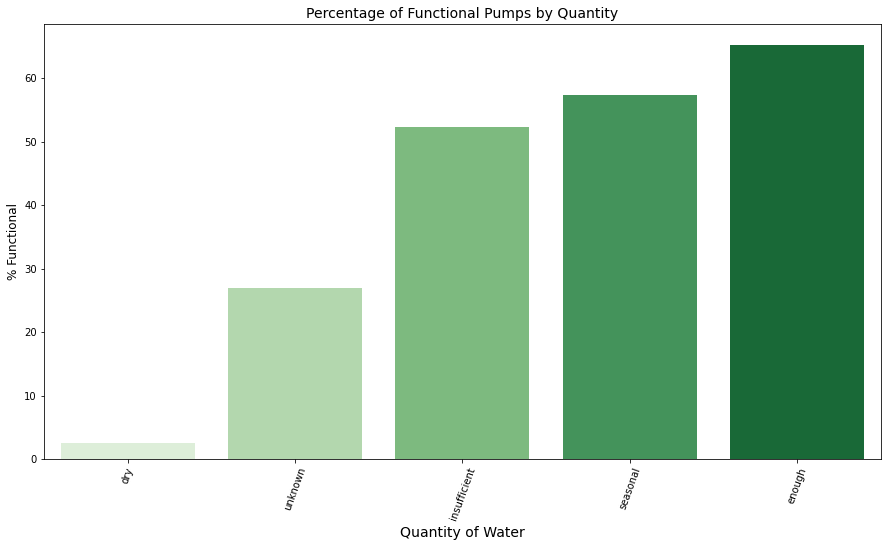

In [469]:
# Create plot to represent percentage of functional pumps by Quantity category
functional_plot2 = sns.barplot(x="name", y="functional_%", data=merged2.sort_values(by=['functional_%']),
                 palette="Greens")
functional_plot2.figure.set_size_inches(15,8)
functional_plot2.set_ylabel('% Functional', size=12)
functional_plot2.set_xlabel('Quantity of Water', size=14)
functional_plot2.set_title('Percentage of Functional Pumps by Quantity', size=14)
functional_plot2.set_xticklabels(functional_plot2.get_xticklabels(), rotation=70);
functional_plot2.figure.savefig('../images/pumpquantity.jpeg', bbox_inches='tight')